In [1]:
using Revise
using ReachabilityAnalysis, SparseArrays, Plots
#using BenchmarkTools
#using LaTeXStrings #, Latexify 
#using Plots, Plots.PlotMeasures

LazySets.set_rtol(Float64, 1e-14);
LazySets.set_ztol(Float64, 1e-14);

┌ Warning: Replacing docs for `LazySets.Approximations.overapproximate :: Union{Tuple{S}, Tuple{T}, Tuple{Array{TaylorModels.TaylorModel1{T,S},1},Type{var"#s24"} where var"#s24"<:Zonotope}} where S where T` in module `LazySets.Approximations`
└ @ Base.Docs docs/Docs.jl:227
┌ Warning: Replacing docs for `LazySets.Approximations.overapproximate :: Union{Tuple{S}, Tuple{T}, Tuple{N}, Tuple{Array{TaylorModels.TaylorModelN{N,T,S},1},Type{var"#s22"} where var"#s22"<:Zonotope}} where S where T where N` in module `LazySets.Approximations`
└ @ Base.Docs docs/Docs.jl:227


In [2]:
function spacecraft(; abort_time::Union{Float64, Vector{Float64}}=-1.)
    # variables
    x  = 1  # x position (negative!)
    y  = 2  # y position (negative!)
    vx = 3  # x velocity
    vy = 4  # y velocity
    t  = 5  # time

    # number of variables
    n = 4 + 1

    # flag for activating the "rendezvous abort" scenario
    aborting = true
    if abort_time isa Number
        if abort_time < 0.
            aborting = false
        else
            t_abort_lower = abort_time
            t_abort_upper = abort_time
        end
    else
        @assert length(abort_time) == 2 "abort time must be a point or an interval"
        t_abort_lower = abort_time[1]
        t_abort_upper = abort_time[2]
    end

    # discrete structure (graph)
    automaton = LightAutomaton(aborting ? 3 : 2)

    # common vector of affine dynamics
    b = sparsevec([t], [1.], n)

    # mode 1 ("approaching")
    A = spzeros(n, n)
    A[x, vx] = 1.
    A[y, vy] = 1.
    A[vx, x] = -0.057599765881773
    A[vx, y] = 0.000200959896519766
    A[vx, vx] = -2.89995083970656
    A[vx, vy] = 0.00877200894463775
    A[vy, x] = -0.000174031357370456
    A[vy, y] = -0.0665123984901026
    A[vy, vx] = -0.00875351105536225
    A[vy, vy] = -2.90300269286856
    invariant = HalfSpace(sparsevec([x], [1.], n), -100.)  # x <= -100
    if aborting
        invariant = HPolyhedron([
            invariant,
            HalfSpace(sparsevec([t], [1.], n), t_abort_upper)  # t <= t_abort_upper
           ])
    end
    m_1 = @system(x' = Ax + b, x ∈ invariant)

    # mode 2 ("rendezvous attempt")
    A = spzeros(n, n)
    A[x, vx] = 1.
    A[y, vy] = 1.
    A[vx, x] = -0.575999943070835
    A[vx, y] = 0.000262486079431672
    A[vx, vx] = -19.2299795908647
    A[vx, vy] = 0.00876275931760007
    A[vy, x] = -0.000262486080737868
    A[vy, y] = -0.575999940191886
    A[vy, vx] = -0.00876276068239993
    A[vy, vy] = -19.2299765959399
    invariant = HPolyhedron([
        HalfSpace(sparsevec([x], [-1.], n), 100.),           # x >= -100
        HalfSpace(sparsevec([x], [1.], n), 100.),            # x <= 100
        HalfSpace(sparsevec([y], [-1.], n), 100.),           # y >= -100
        HalfSpace(sparsevec([y], [1.], n), 100.),            # y <= 100
        HalfSpace(sparsevec([x, y], [-1., -1.], n), 141.1),  # x + y >= -141.1
        HalfSpace(sparsevec([x, y], [1., 1.], n), 141.1),    # x + y <= 141.1
        HalfSpace(sparsevec([x, y], [1., -1.], n), 141.1),   # -x + y >= -141.1
        HalfSpace(sparsevec([x, y], [-1., 1.], n), 141.1)    # -x + y <= 141.1
       ])
    if aborting
        addconstraint!(invariant, HalfSpace(sparsevec([t], [1.], n), t_abort_upper))  # t <= t_abort_upper
    end
    
    m_2 = @system(x' = Ax + b, x ∈ invariant)

    # mode 3 ("aborting")
    A = spzeros(n, n)
    A[x, vx] = 1.
    A[y, vy] = 1.
    A[vx, x] = 0.0000575894721132
    A[vx, vy] = 0.00876276
    A[vy, vx] = -0.00876276
    invariant = Universe(n)
    
    m_3 = @system(x' = Ax + b, x ∈ invariant)

    # modes
    modes = aborting ? [m_1, m_2, m_3] : [m_1, m_2]

    # transition 1 -> 2
    add_transition!(automaton, 1, 2, 1)
    guard = HPolyhedron([
        HalfSpace(sparsevec([x], [-1.], n), 100.),           # x >= -100
        HalfSpace(sparsevec([x], [1.], n), 100.),            # x <= 100
        HalfSpace(sparsevec([y], [-1.], n), 100.),           # y >= -100
        HalfSpace(sparsevec([y], [1.], n), 100.),            # y <= 100
        HalfSpace(sparsevec([x, y], [-1., -1.], n), 141.1),  # x + y >= -141.1
        HalfSpace(sparsevec([x, y], [1., 1.], n), 141.1),    # x + y <= 141.1
        HalfSpace(sparsevec([x, y], [1., -1.], n), 141.1),   # -x + y >= -141.1
        HalfSpace(sparsevec([x, y], [-1., 1.], n), 141.1)    # -x + y <= 141.1
       ])
    t1 = ConstrainedIdentityMap(n, guard)

    # TODO the SpaceEx model is missing the transition from 2 to 1

    if aborting
        add_transition!(automaton, 1, 3, 2)
        guard = HalfSpace(sparsevec([t], [-1.], n), -t_abort_lower)  # t >= t_abort_lower
        t2 = ConstrainedIdentityMap(n, guard)

        add_transition!(automaton, 2, 3, 3)
        guard = HalfSpace(sparsevec([t], [-1.], n), -t_abort_lower)  # t >= t_abort_lower
        t3 = ConstrainedIdentityMap(n, guard)
    end

    # transition annotations
    resetmaps = aborting ? [t1, t2, t3] : [t1]

    H = HybridSystem(automaton, modes, resetmaps, [AutonomousSwitching()])

    # initial condition in mode 1
    X0 = Hyperrectangle([-900., -400., 0., 0., 0.],
                        [25., 25., 0., 0., 0.])
    initial_condition = [(1, X0)]
    
    return IVP(H, initial_condition)
end

spacecraft (generic function with 1 method)

## Safety properties

In [3]:
const x  = 1  # x position (negative!)
const y  = 2  # y position (negative!)
const vx = 3  # x velocity
const vy = 4  # y velocity
const t  = 5  # time

# number of variables
const n = 4 + 1;

const e1 = sparsevec([x], [1.], 5); # direction x
const e2 = sparsevec([y], [1.], 5); # direction y

In [4]:
# safety property in "Mode 2"
const velocity = 0.055 * 60.  # meters per minute
const cx = velocity * cos(π / 8)  # x-coordinate of the octagon's first (ENE) corner
const cy = velocity * sin(π / 8)  # y-coordinate of the octagon's first (ENE) corner
const octagon = [
    HalfSpace(sparsevec([vx], [-1.], n), cx),                # vx >= -cx
    HalfSpace(sparsevec([vx], [1.], n), cx),                 # vx <= cx
    HalfSpace(sparsevec([vy], [-1.], n), cx),                # vy >= -cx
    HalfSpace(sparsevec([vy], [1.], n), cx),                 # vy <= cx
    HalfSpace(sparsevec([vx, vy], [1., 1.], n), cy + cx),    # vx + vy <= cy + cx
    HalfSpace(sparsevec([vx, vy], [1., -1.], n), cy + cx),   # vx - vy <= cy + cx
    HalfSpace(sparsevec([vx, vy], [-1., 1.], n), cy + cx),   # -vx + vy <= cy + cx
    HalfSpace(sparsevec([vx, vy], [-1., -1.], n), cy + cx)   # -vx - vy <= cy + cx
   ]
const tan30 = tan(π/6)
const cone = [
    HalfSpace(sparsevec([x], [-1.], n), 100.),          # x >= -100
    HalfSpace(sparsevec([x, y], [tan30, -1.], n), 0.),  # -x tan(30°) + y >= 0
    HalfSpace(sparsevec([x, y], [tan30, 1.], n), 0.),   # -x tan(30°) - y >= 0
   ];

# safety property in "aborting"
const target = BallInf(zeros(2), 0.2);

In [116]:
function line_of_sight(sol)
    all_idx = findall(x -> x == 2, location.(sol))  # attempt
    for idx in all_idx
        verif = all(set(R) ⊆ HPolyhedron(cone) for R in sol[idx])
        !verif && return false
    end
    return true
end

function velocity_constraint(sol)
    all_idx = findall(x -> x == 2, location.(sol)) # attempt
    for idx in all_idx
        verif = all(set(R) ⊆ HPolyhedron(octagon) for R in sol[idx])
        !verif && return false
    end
    return true
end

function target_avoidance(sol)
    all_idx = findall(x -> x == 3, location.(sol)) # aborting
    for idx in all_idx
        verif = all(!(set(Projection(R, [x, y])) ⊆ target) for R in sol[idx])
        !verif && return false
    end
    return true
end

target_avoidance (generic function with 1 method)

In [6]:
# SRNA01_prob = spacecraft(abort_time=-1.)
# SRA01_prob = spacecraft(abort_time=120.)
# SRA02_prob = spacecraft(abort_time=[120., 125.])
# SRA03_prob = spacecraft(abort_time=[120., 145.])
# SRA04_prob = spacecraft(abort_time=240.)
# SRA05_prob = spacecraft(abort_time=[235., 240.])
# SRA06_prob = spacecraft(abort_time=[230., 240.])
# SRA07_prob = spacecraft(abort_time=[50., 150.])
# SRA08_prob = spacecraft(abort_time=[0., 240.])
# SRU01_prob = spacecraft(abort_time=260.)
# SRU02_prob = spacecraft(abort_time=[0., 260.])

## Results

### SRNA01

In [98]:
GC.gc()
boxdirs = BoxDirections{Float64, Vector{Float64}}(5)
prob = spacecraft(abort_time=-1.);
sol = nothing
@time sol = solve(prob, alg=BOX(δ=0.04), # BFFPSV18(δ=0.04, vars=[1, 2, 3, 4, 5], dim=5),
                  clustering_method=LazyClustering(),
                  intersection_method=TemplateHullIntersection(boxdirs),
                  intersect_source_invariant=false,
                  intersect_source_invariant_method=TemplateHullIntersection(boxdirs),
                  tspan = (0.0 .. 300.0));

  0.329993 seconds (1.26 M allocations: 124.139 MiB, 6.59% gc time)


In [99]:
@show line_of_sight(sol)
@show velocity_constraint(sol)

line_of_sight(sol) = true
velocity_constraint(sol) = true


true

In [44]:
#plot(sol[1], vars=(1, 2), lw=0.0, color=:lightgreen, xlab="x", ylab="y")
#plot!(sol[2], vars=(1, 2), lw=0.0, color=:red)

### SRNA01 (discrete-time)

In [100]:
GC.gc()
prob = spacecraft(abort_time=-1.);
sol = nothing
@time sol = solve(prob, alg=BOX(δ=0.1, approx_model=NoBloating()),
                  clustering_method=LazyClustering(),
                  intersection_method=TemplateHullIntersection(boxdirs),
                  intersect_source_invariant=false,
                  intersect_source_invariant_method=TemplateHullIntersection(boxdirs),
                  tspan = (0.0 .. 300.0));

  0.136554 seconds (504.34 k allocations: 49.722 MiB, 8.54% gc time)


In [101]:
@show line_of_sight(sol)
@show velocity_constraint(sol)

line_of_sight(sol) = true
velocity_constraint(sol) = true


true

### SRA01

In [102]:
GC.gc()
prob = spacecraft(abort_time=120.)
sol = nothing
@time sol = solve(prob, alg=BOX(δ=0.04),
                  clustering_method=LazyClustering(3),
                  intersection_method=TemplateHullIntersection(boxdirs),
                  intersect_source_invariant=false,
                  tspan = (0.0 .. 300.0));

@show line_of_sight(sol)
@show velocity_constraint(sol)
@show target_avoidance(sol)

  0.373786 seconds (1.34 M allocations: 140.481 MiB, 5.97% gc time)
line_of_sight(sol) = true
velocity_constraint(sol) = true
target_avoidance(sol) = true


true

In [69]:
#plot(sol, vars=(1, 2), lw=0.0, color=:lightgreen, xlab="x", ylab="y")

In [70]:
#plot(sol[1], vars=(1, 2), lw=0.0, color=:lightgreen, xlab="x", ylab="y")
#plot!(sol[2], vars=(1, 2), lw=0.0, color=:red)
#plot!(sol[3], vars=(1, 2), lw=0.0, color=:cyan)

### SRA01 (discrete-time)

In [72]:
GC.gc()
prob = spacecraft(abort_time=120.);
sol = nothing
@time sol = solve(prob, alg=BOX(δ=0.1, approx_model=NoBloating()),
                  clustering_method=LazyClustering(3),
                  intersection_method=TemplateHullIntersection(boxdirs),
                  intersect_source_invariant=false,
                  intersect_source_invariant_method=TemplateHullIntersection(boxdirs),
                  tspan = (0.0 .. 300.0));

@show line_of_sight(sol)
@show velocity_constraint(sol)
@show target_avoidance(sol)

  0.147412 seconds (546.86 k allocations: 57.464 MiB, 9.14% gc time)
line_of_sight(sol) = true
velocity_constraint(sol) = true
target_avoidance(sol) = true


true

### SRA02

In [74]:
GC.gc()
prob = spacecraft(abort_time=[120., 125.]);
sol = nothing
@time sol = solve(prob, alg=BOX(δ=0.04), #BFFPSV18(δ=0.04, vars=[1, 2, 3, 4, 5], dim=5),
                  clustering_method=LazyClustering(3),
                  intersection_method=TemplateHullIntersection(BoxDirections(5)),
                  intersect_source_invariant=false,
                  tspan = (0.0 .. 300.0));

@show line_of_sight(sol)
@show velocity_constraint(sol)
@show target_avoidance(sol)

  0.477621 seconds (1.47 M allocations: 150.726 MiB, 5.34% gc time)
line_of_sight(sol) = true
velocity_constraint(sol) = true
target_avoidance(sol) = true


true

### SRA02 (discrete-time)

In [ ]:
# TODO

### SRA03

In [103]:
GC.gc()
prob = spacecraft(abort_time=[120., 145.]);
sol = nothing
@time sol = solve(prob, alg=BOX(δ=0.04),
                  clustering_method=LazyClustering(3),
                  intersection_method=TemplateHullIntersection(boxdirs),
                  intersect_source_invariant=false,
                  tspan = (0.0 .. 300.0));

@show line_of_sight(sol)
@show velocity_constraint(sol)
@show target_avoidance(sol)

  0.472242 seconds (1.64 M allocations: 172.746 MiB, 4.93% gc time)
line_of_sight(sol) = true
velocity_constraint(sol) = true
target_avoidance(sol) = true


true

### SRA04

In [104]:
GC.gc()
prob = spacecraft(abort_time=240.);
sol = nothing
@time sol = solve(prob, alg=BOX(δ=0.04),
                  clustering_method=LazyClustering(3),
                  intersection_method=TemplateHullIntersection(BoxDirections(5)),
                  intersect_source_invariant=false, #TemplateHullIntersection(BoxDirections(5)),
                  tspan = (0.0 .. 300.0));

@show line_of_sight(sol)
@show velocity_constraint(sol)
@show target_avoidance(sol)

  0.714136 seconds (2.57 M allocations: 264.639 MiB, 5.42% gc time)
line_of_sight(sol) = true
velocity_constraint(sol) = true
target_avoidance(sol) = true


true

### SRA05

In [105]:
GC.gc()
prob = spacecraft(abort_time=[235., 240.]);
sol = nothing
@time sol = solve(prob, alg=BOX(δ=0.04),
                  clustering_method=LazyClustering(3),
                  intersection_method=TemplateHullIntersection(boxdirs),
                  intersect_source_invariant=false,
                  tspan = (0.0 .. 300.0));

@show line_of_sight(sol)
@show velocity_constraint(sol)
@show target_avoidance(sol)

  0.797236 seconds (2.58 M allocations: 265.996 MiB, 6.61% gc time)
line_of_sight(sol) = true
velocity_constraint(sol) = true
target_avoidance(sol) = true


true

### SRA06

In [106]:
GC.gc()
prob = spacecraft(abort_time=[230., 240.]);
sol = nothing
@time sol = solve(prob, alg=BOX(δ=0.04),
                  clustering_method=LazyClustering(),
                  intersection_method=TemplateHullIntersection(boxdirs),
                  intersect_source_invariant=false,
                  tspan = (0.0 .. 300.0));

@show line_of_sight(sol)
@show velocity_constraint(sol)
@show target_avoidance(sol)

  0.430274 seconds (1.42 M allocations: 137.866 MiB, 5.89% gc time)
line_of_sight(sol) = true
velocity_constraint(sol) = true
target_avoidance(sol) = true


true

### SRA07

In [120]:
GC.gc()
prob = spacecraft(abort_time=[50., 150.]);
sol = nothing
@time sol = solve(prob, alg=BOX(δ=0.04),
                  clustering_method=LazyClustering(),
                  intersection_method=TemplateHullIntersection(boxdirs),
                  intersect_source_invariant=false,
                  tspan = (0.0 .. 300.0));

@show line_of_sight(sol)
@show velocity_constraint(sol)
@show target_avoidance(sol)

  0.286964 seconds (1.14 M allocations: 109.799 MiB, 3.47% gc time)
asdf
line_of_sight(sol) = true
asdf
velocity_constraint(sol) = true
target_avoidance(sol) = true


true

In [121]:
location.(sol)

4-element Array{Int64,1}:
 1
 3
 2
 3

### SRA08

In [114]:
GC.gc()
prob = spacecraft(abort_time=[0., 240.]);
sol = nothing
@time sol = solve(prob, alg=BOX(δ=0.04),
                  clustering_method=LazyClustering(),
                  intersection_method=TemplateHullIntersection(boxdirs),
                  intersect_source_invariant=false,
                  tspan = (0.0 .. 300.0));

@show line_of_sight(sol)
@show velocity_constraint(sol)
@show target_avoidance(sol)

  0.519804 seconds (1.50 M allocations: 149.815 MiB, 5.51% gc time)
line_of_sight(sol) = true
velocity_constraint(sol) = true
target_avoidance(sol) = true


true

---

In [16]:
# SRU01
# Using one block of size 5
GC.gc()
prob = spacecraft(abort_time=260.);
sol = nothing
@time sol = solve(prob, alg=BFFPSV18(δ=0.04, vars=[1, 2, 3, 4, 5], dim=5),
                  clustering_method=LazyClustering(),
                  intersection_method=TemplateHullIntersection(BoxDirections(5)),
                  intersect_source_invariant=false, #TemplateHullIntersection(BoxDirections(5)),
                  tspan = (0.0 .. 300.0));
safety_properties(sol, octagon, cone, target)

  2.581007 seconds (5.35 M allocations: 440.101 MiB, 2.89% gc time)


true

In [28]:
# SRU02
# Using one block of size 5
GC.gc()
prob = spacecraft(abort_time=[0., 260.]);
sol = nothing
@time sol = solve(prob, alg=BFFPSV18(δ=0.04, vars=[1, 2, 3, 4, 5], dim=5),
                  clustering_method=LazyClustering(),
                  intersection_method=TemplateHullIntersection(BoxDirections{Float64, Vector{Float64}}(5)),
                  # intersection_method=TemplateHullIntersection(BoxDirections(5)),
                  intersect_source_invariant=true, #TemplateHullIntersection(BoxDirections(5)),
                  tspan = (0.0 .. 300.0));
safety_properties(sol, octagon, cone, target)

  8.157166 seconds (18.67 M allocations: 1.493 GiB, 3.31% gc time)


false

In [29]:
plot(sol[2], vars=[1, 2], lw=0.0)

----

### alg=BOX

In [9]:
GC.gc()
SRNA01_prob = spacecraft(abort_time=-1.);
SRNA01_sol = nothing
@time SRNA01_sol = solve(SRNA01_prob, alg=BOX(δ=0.04), tspan = (0.0 .. 300.0));

  6.829318 seconds (9.70 M allocations: 907.830 MiB, 2.09% gc time)


In [7]:
location.(SRNA01_sol)

2-element Array{Int64,1}:
 1
 2

In [8]:
numrsets(SRNA01_sol)

7572

In [8]:
plot(SRNA01_sol, vars=(1, 2), lw=0.0, xlab="x", ylab="y")

In [9]:
GC.gc()
SRA01_prob = spacecraft(abort_time=120.);
SRA01_sol = nothing
@time SRA01_sol = solve(SRA01_prob, alg=BOX(δ=0.04), tspan = (0.0 .. 300.0));

  2.667352 seconds (4.53 M allocations: 385.636 MiB, 2.47% gc time)


In [10]:
plot(SRA01_sol, vars=(1, 2), lw=0.0, xlab="x", ylab="y")

### alg=BFFPSV18

In [10]:
prob = spacecraft(abort_time=-1.);

In [15]:
# Using blocks of size 1
GC.gc()
sol = nothing
@time sol = solve(prob, alg=BFFPSV18(δ=0.04, vars=[1, 2, 3, 4, 5], dim=5),
                  clustering_method=BoxClustering(), tspan = (0.0 .. 300.0));

  5.460786 seconds (11.27 M allocations: 912.465 MiB, 3.21% gc time)


In [16]:
# Using blocks of size 5
GC.gc()
sol = nothing
@time sol = solve(prob, alg=BFFPSV18(δ=0.04, partition=[1:5]),
                  clustering_method=BoxClustering(), tspan = (0.0 .. 300.0));

  8.324508 seconds (15.57 M allocations: 1.377 GiB, 2.98% gc time)


In [ ]:
plot(sol[2], vars=[1, 2], lw=0.0)

----

## Buscando mejor configuración del solve usando BFFPSV18

In [25]:
GC.gc()
prob = spacecraft(abort_time=-1.);
sol = nothing
@time sol = solve(prob, alg=BFFPSV18(δ=0.04, partition=[1:5]),
                  clustering_method=LazyClustering(), #Clustering lazy: sobre-aproxima por ConvexHull usando
                                                      #funciones de soporte, lo cual es muy eficiente.
                  intersection_method=TemplateHullIntersection(BoxDirections(5)),
                  intersect_source_invariant=false, #TemplateHullIntersection(BoxDirections(5)),
                  tspan = (0.0 .. 300.0));

  2.464569 seconds (4.97 M allocations: 459.645 MiB, 3.39% gc time)


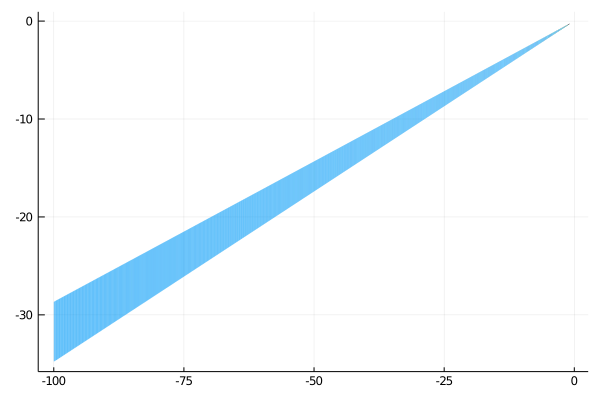

In [20]:
plot(sol[2], vars=[1, 2], lw=0.0)

In [32]:
#MEJOR OPCIÓN:

# Using one block of size 5
GC.gc()
prob = spacecraft(abort_time=-1.);
sol = nothing
@time sol = solve(prob, alg=BFFPSV18(δ=0.04, vars=[1, 2, 3, 4, 5], dim=5),
                  clustering_method=LazyClustering(), #Clustering lazy: sobre-aproxima por ConvexHull usando
                                                      #funciones de soporte, lo cual es muy eficiente.
                  intersection_method=TemplateHullIntersection(BoxDirections(5)),
                  intersect_source_invariant=false, #TemplateHullIntersection(BoxDirections(5)),
                  tspan = (0.0 .. 300.0));

  2.275058 seconds (5.23 M allocations: 431.611 MiB, 3.99% gc time)


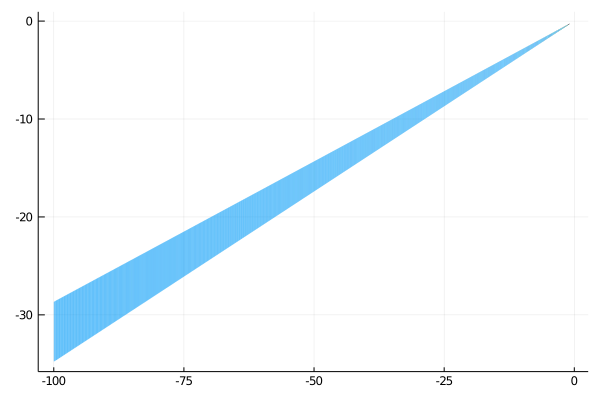

In [22]:
plot(sol[2], vars=[1, 2], lw=0.0)

In [33]:
#MEJOR OPCIÓN:

# Using one block of size 5
GC.gc()
prob = spacecraft(abort_time=-1.);
sol = nothing
@time sol = solve(prob, alg=BFFPSV18(δ=0.04, vars=[1, 2, 3, 4, 5], dim=5),
                  clustering_method=BoxClustering(), #Clustering concreto
                  intersection_method=TemplateHullIntersection(BoxDirections(5)),
                  intersect_source_invariant=false, #TemplateHullIntersection(BoxDirections(5)),
                  tspan = (0.0 .. 300.0));

  2.557901 seconds (5.23 M allocations: 431.729 MiB, 3.35% gc time)


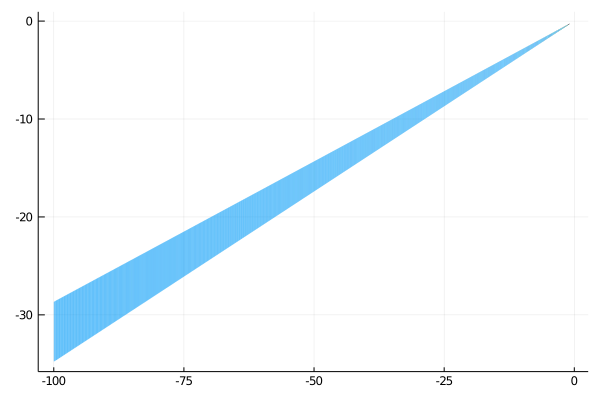

In [34]:
plot(sol[2], vars=[1, 2], lw=0.0)

In [23]:
GC.gc()
prob = spacecraft(abort_time=-1.);
sol = nothing
@time sol = solve(prob, alg=BFFPSV18(δ=0.04, vars=[1, 2, 3, 4, 5], dim=5),
                  clustering_method=LazyClustering(), #Clustering lazy: sobre-aproxima por ConvexHull usando
                                                      #funciones de soporte, lo cual es muy eficiente.
                  intersection_method=TemplateHullIntersection(BoxDirections{Float64, Vector{Float64}}(5)),
                  # intersection_method=TemplateHullIntersection(BoxDirections(5)),
                  intersect_source_invariant=true, #RECORTA PARTES DE LOS ReachSets AFUERA DEL SOURCE INVARIANT I⁻
                  tspan = (0.0 .. 300.0));

  6.080830 seconds (11.26 M allocations: 912.189 MiB, 3.38% gc time)


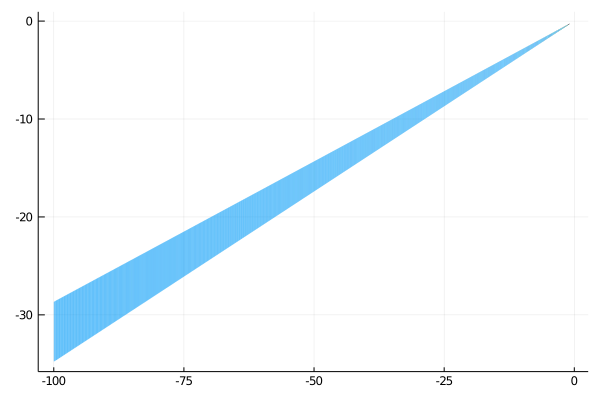

In [24]:
plot(sol[2], vars=[1, 2], lw=0.0)

----

In [19]:
# Using one block of size 5
GC.gc()
SRA02_prob = spacecraft(abort_time=[120., 125.]);

#alg = BFFPSV18(δ=0.04, vars=[1, 2, 3, 4, 5], dim=5)
alg = BOX(δ=0.04)

sol = nothing
@time sol = solve(SRA02_prob, alg=alg,
                  clustering_method=LazyClustering(4),
                  intersection_method=TemplateHullIntersection(BoxDirections(5)),
                  intersect_source_invariant=false, #TemplateHullIntersection(BoxDirections(5)),
                  tspan = (0.0 .. 300.0));

  0.633470 seconds (1.72 M allocations: 190.389 MiB, 7.33% gc time)


In [ ]:
#plot(sol, vars=[1, 2], lw=0.0)

In [27]:
# Using one block of size 5
GC.gc()
SRA02_prob = spacecraft(abort_time=[120., 125.]);

#alg = BFFPSV18(δ=0.04, vars=[1, 2, 3, 4, 5], dim=5)
alg = BOX(δ=0.04)

sol = nothing
@time sol = solve(SRA02_prob, alg=alg,
                  clustering_method=LazyClustering(4),
                  intersection_method=TemplateHullIntersection(BoxDirections{Float64, Vector{Float64}}(5)),
                  #intersection_method=TemplateHullIntersection(BoxDirections(5)),
                  intersect_source_invariant=true, #TemplateHullIntersection(BoxDirections(5)),
                  tspan = (0.0 .. 300.0));

  6.894852 seconds (10.83 M allocations: 997.272 MiB, 4.89% gc time)


In [ ]:
plot(sol, vars=[1, 2], lw=0.0)

-----

In [28]:
GC.gc()
SRA01_prob = spacecraft(abort_time=120.);
SRA01_sol_BFF = nothing
@time SRA01_sol_BFF = solve(SRA01_prob, alg=BFFPSV18(δ=0.04, view=true, setrep=Hyperrectangle, vars=[1, 2],
                            partition=[1:5]),
                            clustering_method=BoxClustering(), #default
                            tspan = (0.0 .. 300.0));

  5.577888 seconds (9.92 M allocations: 792.840 MiB, 6.57% gc time)


In [29]:
GC.gc()
SRA01_prob = spacecraft(abort_time=120.);
SRA01_sol_BFF = nothing
@time SRA01_sol_BFF = solve(SRA01_prob, alg=BFFPSV18(δ=0.04, view=true, setrep=Hyperrectangle,
                            vars=[1, 2, 3, 4, 5], dim=5),
                            clustering_method=BoxClustering(), #default
                            tspan = (0.0 .. 300.0));

  4.807760 seconds (10.14 M allocations: 790.747 MiB, 3.92% gc time)


In [ ]:
sol_polys = sol2polys(SRA01_sol_BFF, e1, e2);
fig = Plots.plot()
plot!(fig, [X for X in sol_polys[1:10:end]], color=:lightblue, lw=1.0, linecolor=:black)

In [16]:
GC.gc()
SRA02_prob = spacecraft(abort_time=[120., 125.]);
SRA02_sol_BFF = nothing
@time SRA02_sol_BFF = solve(SRA02_prob, alg=BFFPSV18(δ=0.04, view=true, setrep=Hyperrectangle, vars=[1, 2], partition=[1:5]),
                            tspan = (0.0 .. 300.0));

  4.178865 seconds (8.08 M allocations: 695.111 MiB, 3.71% gc time)


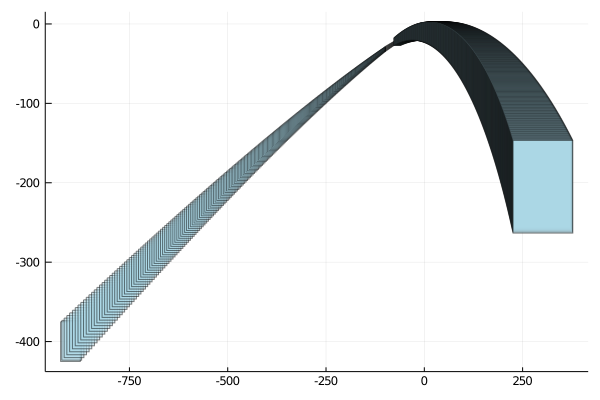

In [17]:
sol_polys = sol2polys(SRA02_sol_BFF, e1, e2);
fig = Plots.plot()
plot!(fig, [X for X in sol_polys[1:10:end]], color=:lightblue, lw=1.0, linecolor=:black)

## Safety verifications

In [18]:
#=
SRNA01_prob = spacecraft(abort_time=-1.)
SRA01_prob = spacecraft(abort_time=120.)
SRA02_prob = spacecraft(abort_time=[120., 125.])
SRA03_prob = spacecraft(abort_time=[120., 145.])
SRA04_prob = spacecraft(abort_time=240.)
SRA05_prob = spacecraft(abort_time=[235., 240.])
SRA06_prob = spacecraft(abort_time=[230., 240.])
SRA07_prob = spacecraft(abort_time=[50., 150.])
SRA08_prob = spacecraft(abort_time=[0., 240.])
SRU01_prob = spacecraft(abort_time=260.)
SRU02_prob = spacecraft(abort_time=[0., 260.])
=#

In [19]:
GC.gc()
SRNA01_prob = spacecraft(abort_time=-1);
sol = nothing
@time sol = solve(SRNA01_prob, alg=BFFPSV18(δ=0.04, view=true, setrep=Hyperrectangle, vars=[1, 2], partition=[1:5]),
                            tspan = (0.0 .. 300.0));
safety_properties(sol, octagon, cone, target)

TypeError: TypeError: in keyword argument abort_time, expected Union{Float64, Array{Float64,1}}, got a value of type Int64

In [20]:
GC.gc()
SRA01_prob = spacecraft(abort_time=120.);
sol = nothing
@time sol = solve(SRA01_prob, alg=BFFPSV18(δ=0.04, view=true, setrep=Hyperrectangle, vars=[1, 2], partition=[1:5]),
                            tspan = (0.0 .. 300.0));
safety_properties(sol, octagon, cone, target)

  3.838241 seconds (7.77 M allocations: 666.773 MiB, 3.62% gc time)


true

In [21]:
GC.gc()
SRA02_prob = spacecraft(abort_time=[120., 125.]);
sol = nothing
@time sol = solve(SRA02_prob, alg=BFFPSV18(δ=0.04, view=true, setrep=Hyperrectangle, vars=[1, 2], partition=[1:5]),
                            tspan = (0.0 .. 300.0));
safety_properties(sol, octagon, cone, target)

  4.032176 seconds (8.08 M allocations: 695.111 MiB, 3.53% gc time)


true

In [22]:
GC.gc()
SRA03_prob = spacecraft(abort_time=[120., 145.]);
sol = nothing
@time sol = solve(SRA03_prob, alg=BFFPSV18(δ=0.04, view=true, setrep=Hyperrectangle, vars=[1, 2], partition=[1:5]),
                            tspan = (0.0 .. 300.0));
safety_properties(sol, octagon, cone, target)

  4.518979 seconds (9.31 M allocations: 808.713 MiB, 3.59% gc time)


true

In [23]:
GC.gc()
SRA04_prob = spacecraft(abort_time=240.);
sol = nothing
@time sol = solve(SRA04_prob, alg=BFFPSV18(δ=0.04, view=true, setrep=Hyperrectangle, vars=[1, 2], partition=[1:5]),
                            tspan = (0.0 .. 300.0));
safety_properties(sol, octagon, cone, target)

  8.429613 seconds (14.41 M allocations: 1.248 GiB, 3.40% gc time)


true

In [24]:
GC.gc()
SRA05_prob = spacecraft(abort_time=[235., 240.]);
sol = nothing
@time sol = solve(SRA05_prob, alg=BFFPSV18(δ=0.04, view=true, setrep=Hyperrectangle, vars=[1, 2], partition=[1:5]),
                            tspan = (0.0 .. 300.0));
safety_properties(sol, octagon, cone, target)

  7.757153 seconds (14.44 M allocations: 1.251 GiB, 3.40% gc time)


true

In [25]:
GC.gc()
SRA06_prob = spacecraft(abort_time=[230., 240.]);
sol = nothing
@time sol = solve(SRA06_prob, alg=BFFPSV18(δ=0.04, view=true, setrep=Hyperrectangle, vars=[1, 2], partition=[1:5]),
                            tspan = (0.0 .. 300.0));
safety_properties(sol, octagon, cone, target)

  7.495928 seconds (14.48 M allocations: 1.254 GiB, 3.43% gc time)


true

In [26]:
GC.gc()
SRA07_prob = spacecraft(abort_time=[50., 150.]);
sol = nothing
@time sol = solve(SRA07_prob, alg=BFFPSV18(δ=0.04, view=true, setrep=Hyperrectangle, vars=[1, 2], partition=[1:5]),
                            tspan = (0.0 .. 300.0));
safety_properties(sol, octagon, cone, target)

  4.317930 seconds (11.24 M allocations: 981.842 MiB, 4.76% gc time)


false

In [27]:
GC.gc()
SRA08_prob = spacecraft(abort_time=[0., 240.]);
sol = nothing
@time sol = solve(SRA08_prob, alg=BFFPSV18(δ=0.04, view=true, setrep=Hyperrectangle, vars=[1, 2], partition=[1:5]),
                            tspan = (0.0 .. 300.0));
safety_properties(sol, octagon, cone, target)

  7.479506 seconds (17.12 M allocations: 1.486 GiB, 4.17% gc time)


false

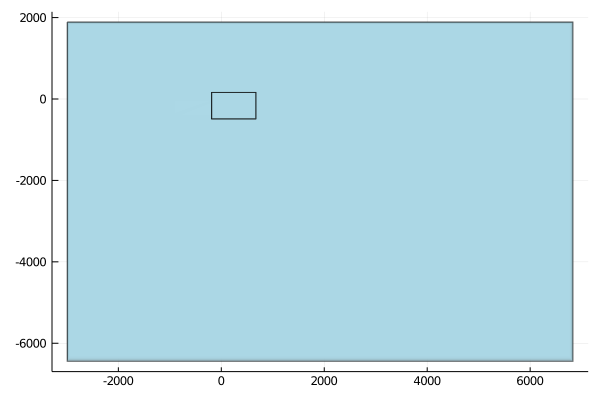

In [28]:
sol_polys = sol2polys(sol, e1, e2);
fig = Plots.plot()
plot!(fig, [X for X in sol_polys[1:10:end]], color=:lightblue, lw=1.0, linecolor=:black)

In [29]:
GC.gc()
SRU01_prob = spacecraft(abort_time=260.);
sol = nothing
@time sol = solve(SRU01_prob, alg=BFFPSV18(δ=0.04, view=true, setrep=Hyperrectangle, vars=[1, 2], partition=[1:5]),
                            tspan = (0.0 .. 300.0));
safety_properties(sol, octagon, cone, target)

  7.947960 seconds (15.52 M allocations: 1.349 GiB, 3.51% gc time)


true

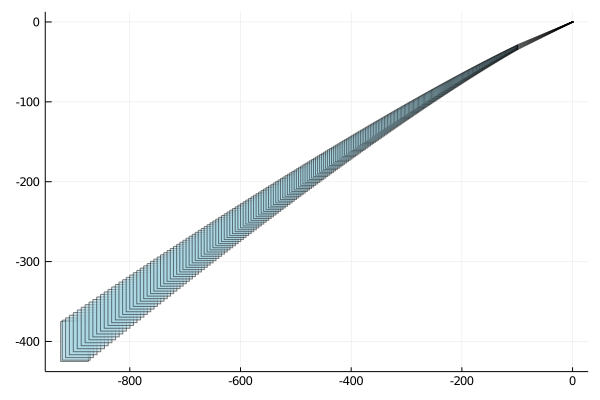

In [30]:
sol_polys = sol2polys(sol, e1, e2);
fig = Plots.plot()
plot!(fig, [X for X in sol_polys[1:10:end]], color=:lightblue, lw=1.0, linecolor=:black)

In [39]:
GC.gc()
SRU02_prob = spacecraft(abort_time=[0., 260.]);
sol = nothing
@time sol = solve(SRU02_prob, alg=BFFPSV18(δ=0.04, view=true, setrep=Hyperrectangle,
                                           vars=[1, 2], partition=[1:5]),
                                           clustering_method=BoxClustering(2),
                                           tspan = (0.0 .. 300.0));
safety_properties(sol, octagon, cone, target)

 18.584423 seconds (33.03 M allocations: 2.897 GiB, 5.06% gc time)


false

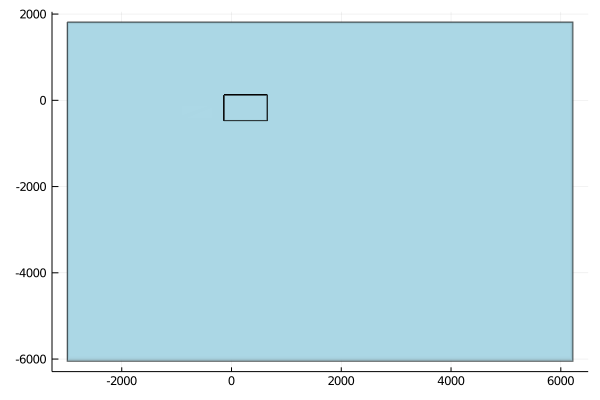

In [40]:
sol_polys = sol2polys(sol, e1, e2);
fig = Plots.plot()
plot!(fig, [X for X in sol_polys[1:10:end]], color=:lightblue, lw=1.0, linecolor=:black)

In [41]:
GC.gc()
prueba_prob = spacecraft(abort_time=[0., 150.]);
sol = nothing
@time sol = solve(prueba_prob, alg=BFFPSV18(δ=0.04, view=true, setrep=Hyperrectangle,
                                           vars=[1, 2], partition=[1:5]),
                                           clustering_method=BoxClustering(2),
                                           tspan = (0.0 .. 300.0));
safety_properties(sol, octagon, cone, target)

 12.056148 seconds (19.43 M allocations: 1.677 GiB, 5.56% gc time)


false

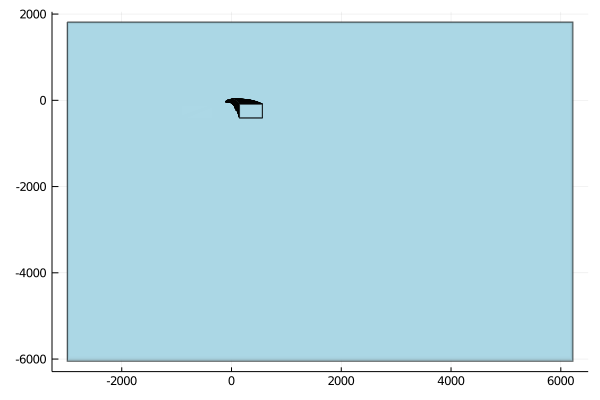

In [42]:
sol_polys = sol2polys(sol, e1, e2);
fig = Plots.plot()
plot!(fig, [X for X in sol_polys[1:10:end]], color=:lightblue, lw=1.0, linecolor=:black)

In [55]:
F=flowpipe(sol);
fp_modo1 = F[1];
fp_modo2 = F[2];
fp_modo3 = F[3];

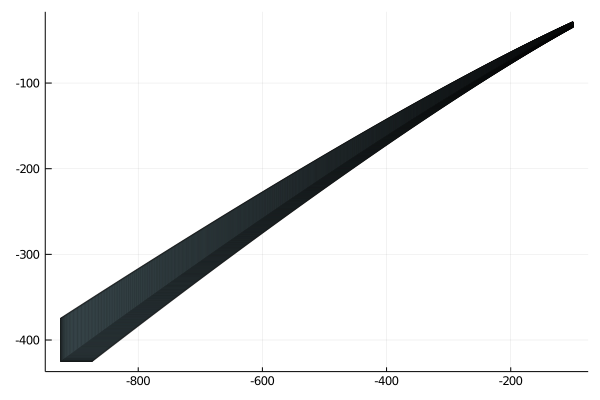

In [56]:
fig = Plots.plot()
plot!(fig, [set(Projection(R,[x,y])) for R in fp_modo1], color=:lightblue, lw=1.0, linecolor=:black)

In [57]:
fig = Plots.plot()
plot!(fig, [set(Projection(R,[x,y])) for R in fp_modo2], color=:lightblue, lw=1.0, linecolor=:black)

In [ ]:
fig = Plots.plot()
plot!(fig, [set(Projection(R,[x,y])) for R in fp_modo3], color=:lightblue, lw=1.0, linecolor=:black)